# Task-4 Image Reconstruction using Matrix Factorisation

### Importing Required Libraries

In [27]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

# remove all warnings
import warnings
warnings.filterwarnings('ignore')

%matplotlib inline
%config InlineBackend.figure_format = 'retina'


try:
    from einops import rearrange
except ImportError:
    %pip install einops
    from einops import rearrange

In [28]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision


device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

In [29]:
# Setting the seed for Python, NumPy, and PyTorch (both CPU and GPU)
def set_seed(seed=42):
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)  # if using CUDA
    torch.cuda.manual_seed_all(seed)  # for multi-GPU
    torch.backends.cudnn.deterministic = True  # Ensures deterministic behavior
    torch.backends.cudnn.benchmark = False     # Disables the auto-tuner that finds the best algorithm

# Call this function before using any random number generators
set_seed(42)

### Matrix Factorization Functions

In [30]:
# Function to normalize the image
def normalize_image(image_tensor):
    image_tensor = image_tensor.float() / 255.0
    return image_tensor

# Function to denormalize the image
def denormalize_image(image_tensor):
    denormalized_image = image_tensor * 255.0
    return denormalized_image.to(torch.float)

def mask_image(image, mask_proportion=0.1, mask_value = float('nan')):
    if not isinstance(image, torch.Tensor):
        raise TypeError("Input 'image' must be a torch.Tensor.")
    
    if not (0 <= mask_proportion <= 1):
        raise ValueError("'mask_proportion' must be between 0 and 1.")
    
    img_copy = image.clone()
    mask = torch.rand(image.shape) < mask_proportion
    img_copy[mask] = mask_value

    return img_copy, mask


def matrix_factorization(image_tensor, rank, learning_rate=0.01, num_epochs=5000, tol = 1e-6, device=torch.device("cpu")):
    """
    Perform matrix factorization using Alternating Least Squares (ALS) algorithm.
    
    Args:
        image_tensor (torch.Tensor): The image tensor to be factorized.
        rank (int): The rank of the factorization.
        learning_rate (float): The learning rate for optimization.
        num_epochs (int): The number of epochs to train the model.
        tol (float): The tolerance for convergence.
        device (torch.device): The device to run the optimization.
    
    Returns:
        W (torch.Tensor): The basis matrix.
        H (torch.Tensor): The coefficient matrix.
        loss (torch.Tensor): The final loss.
        losses (list): The list of losses at each epoch.
    """

    image_tensor = image_tensor.to(device)
    height, width = image_tensor.shape
    # Initialize the factors randomly
    W = torch.randn(height, rank, requires_grad=True, device=device)
    H = torch.randn(rank, width, requires_grad=True, device=device)
    # Optimizer
    optimizer = optim.Adam([W, H], lr=learning_rate)
    mask = ~torch.isnan(image_tensor)
    # Train the model
    losses = []
    prev_loss = float('inf')
    for i in range(1, num_epochs+1):
        # Compute the loss
        diff_matrix = torch.mm(W, H) - image_tensor
        diff_vector = diff_matrix[mask]
        loss = torch.norm(diff_vector)
        losses.append(loss.item())
        if i % 1000 == 0:
            print(f"Iteration {i}, loss: {loss.item()}")

        if abs(prev_loss - loss.item()) < tol:
            print(f"Converged at iteration {i}, loss: {loss.item()}")
            break
        prev_loss = loss.item()
        
        # Zero the gradients
        optimizer.zero_grad()

        # Backpropagate
        loss.backward()

        # Update the parameters
        optimizer.step()

    return W, H, loss, losses


def plot_images(original, masked, reconstructed,rank, mask_value):
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    fig.suptitle(f"Image Reconstruction with Rank={rank} and Mask={mask_value}")
    # Original image
    axes[0].imshow(original.cpu().detach().numpy(), cmap='gray')
    axes[0].set_title("Original Image")
    axes[0].axis('off')
    # Masked image
    axes[1].imshow(masked.cpu().detach().numpy(), cmap='gray')
    axes[1].set_title("Masked Image")
    axes[1].axis('off')
    # Reconstructed image
    axes[2].imshow(reconstructed.cpu().detach().numpy(), cmap='gray')
    axes[2].set_title("Reconstructed Image")
    axes[2].axis('off')
    plt.show()


def calculate_rmse_psnr(original, reconstructed):
    # Ensure both tensors are on the same device
    if original.device != reconstructed.device:
        original = original.to(reconstructed.device)   
    mse = F.mse_loss(reconstructed, original)
    rmse = torch.sqrt(mse)
    print(f"RMSE: {rmse.item()}")
    
    # PSNR: Peak Signal to Noise Ratio
    max_pixel_value = 1.0  # Since image is normalized to [0,1]
    psnr = 20 * torch.log10(max_pixel_value / torch.sqrt(mse))
    print(f"PSNR: {psnr.item()}")

    return rmse.item(), psnr.item()

# Question 4.1

Q1. Pick an image of your liking and reconstruct it using matrix factorization. Choose a suitable value for the rank 
r
. Run Gradient Descent until it converges, plot the reconstructed image alongside the original image. Calculate and report the RMSE and PSNR metrics.

### Load Image

In [5]:
# image completion
import os

if os.path.exists("iitgn.jpg"):
    print("iitgn.jpg already exists")
else:
    !curl -o iitgn.jpg "https://news.iitgn.ac.in/wp/wp-content/uploads/2019/07/ANK383_2224a-1280x640.jpg"

iitgn.jpg already exists


Min pixel value: 0.0
Max pixel value: 1.0


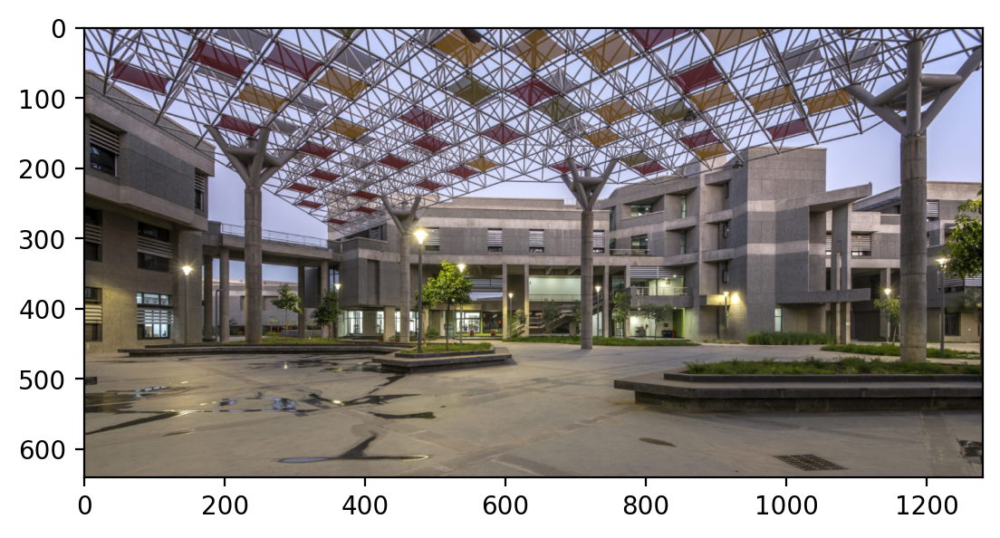

In [6]:
# Load and preprocess image
color_img = torchvision.io.read_image("./iitgn.jpg")
color_img = color_img.to(dtype=torch.float32)  # Ensure tensor is of type float

# Normalize the image
color_img = normalize_image(color_img)
# check min and max
print("Min pixel value:", color_img.min().item())
print("Max pixel value:", color_img.max().item())
plt.imshow(color_img.permute(1, 2, 0))

### Convert image to grayscale

torch.Size([640, 1280])


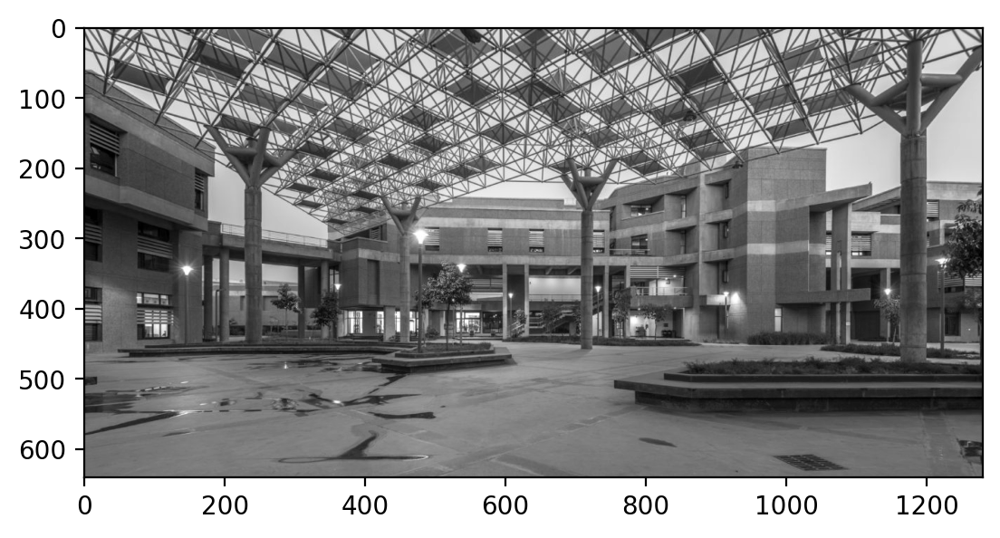

In [7]:
# Make grayscale
gray_img = torch.tensor(color_img, dtype=torch.float)
gray_img = gray_img.mean(dim=0, keepdim=False)
print(gray_img.shape)
plt.imshow(gray_img, cmap='gray')

### Crop the image

torch.Size([600, 600])


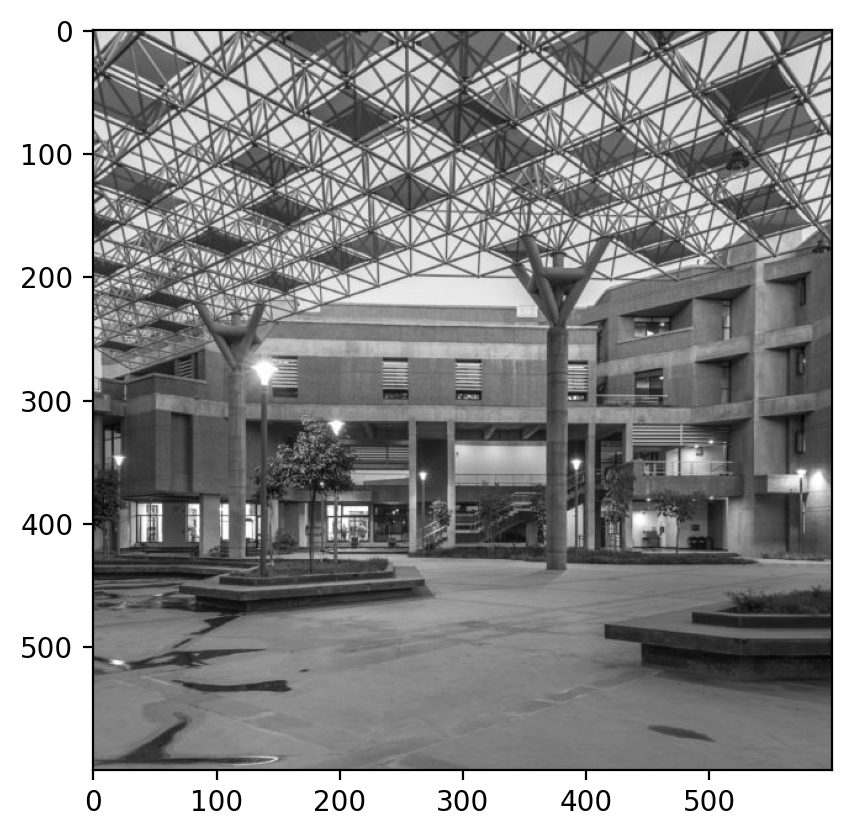

In [8]:
crop = torchvision.transforms.CenterCrop(600)
img_cropped = crop(gray_img)
print(img_cropped.shape)

plt.imshow(img_cropped, cmap='gray')

### Mask some random % of the image

In [9]:
masked_img, mask = mask_image(img_cropped, mask_proportion=0.3)
mask.sum()

tensor(108480)

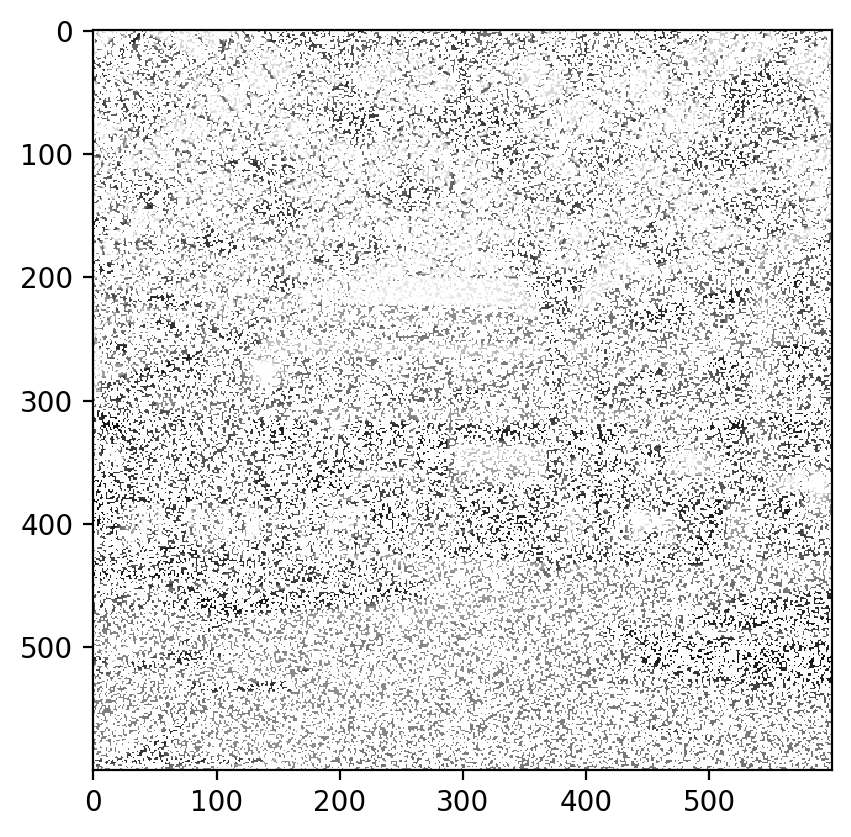

In [10]:
plt.imshow(masked_img, cmap='gray')

### Image reconstruction after masking some proportion of the image 

In [11]:
def image_reconstruction_random(image_tensor, rank, mask_proportion=0.1, learning_rate=0.01, num_epochs=5000, tol=1e-6, device=torch.device("cpu")):
    """
    Perform image reconstruction using random masking and matrix factorization.
    Args:
        image_tensor (torch.Tensor): The input image tensor to be reconstructed.
        rank (int): The rank for matrix factorization.
        mask_proportion (float, optional): The proportion of the image to mask. Default is 0.1.
        learning_rate (float, optional): The learning rate for matrix factorization. Default is 0.01.
        num_epochs (int, optional): The number of epochs for matrix factorization. Default is 5000.
        tol (float, optional): The tolerance for convergence in matrix factorization. Default is 1e-6.
        device (torch.device, optional): The device to perform computations on. Default is CPU.
    Returns:
        reconstructed (torch.Tensor): The reconstructed image tensor.
        masked_img (torch.Tensor): The masked image tensor.
        loss (float): The final loss value after matrix factorization.
        losses (list): The list of loss values over epochs.
        rmse (float): The Root Mean Square Error between the original and reconstructed image.
        psnr (float): The Peak Signal-to-Noise Ratio between the original and reconstructed image.
    """
    
    image_tensor = image_tensor.to(device)
    # Mask the image
    masked_img, mask = mask_image(image_tensor, mask_proportion)
    # Factorize the masked_img image
    W, H, loss, losses = matrix_factorization(masked_img, rank, learning_rate, num_epochs, tol, device)
    # Reconstruct the image
    reconstructed = torch.mm(W, H)
    # Clamp the images to [0, 1]
    reconstructed = torch.clamp(reconstructed, 0, 1)
    # Calculate RMSE and PSNR
    rmse, psnr = calculate_rmse_psnr(image_tensor, reconstructed)
    # Plot the original and reconstructed
    plot_images(image_tensor, masked_img, reconstructed, rank, mask_proportion)
    
    return reconstructed, masked_img, loss, losses,  rmse, psnr


Iteration 1000, loss: 48.87697219848633
Iteration 2000, loss: 41.28812026977539
Iteration 3000, loss: 37.62129211425781
Iteration 4000, loss: 35.684207916259766
Iteration 5000, loss: 34.79819869995117
Converged at iteration 5814, loss: 34.45172882080078
RMSE: 0.08054604381322861
PSNR: 21.879117965698242


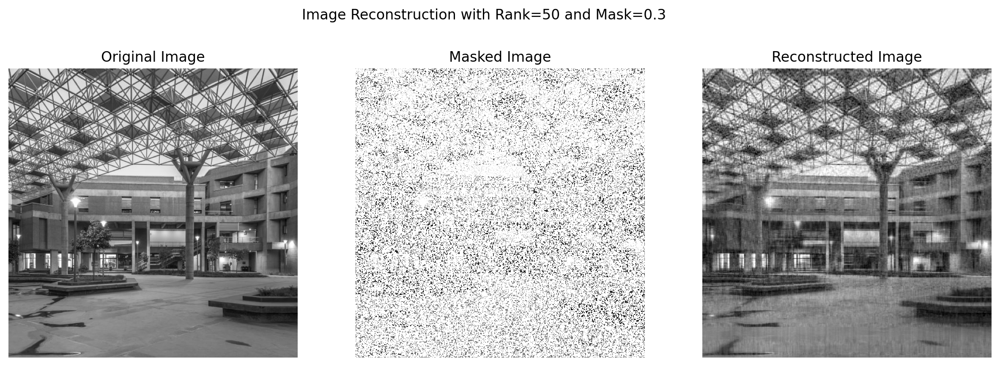

In [12]:
reconstructed_img, masked_img, loss, losses, rmse, psnr = image_reconstruction_random(img_cropped, 50, mask_proportion=0.3, learning_rate=0.01, num_epochs=10000, device=device)

Text(0.5, 1.0, 'Loss vs. Epoch')

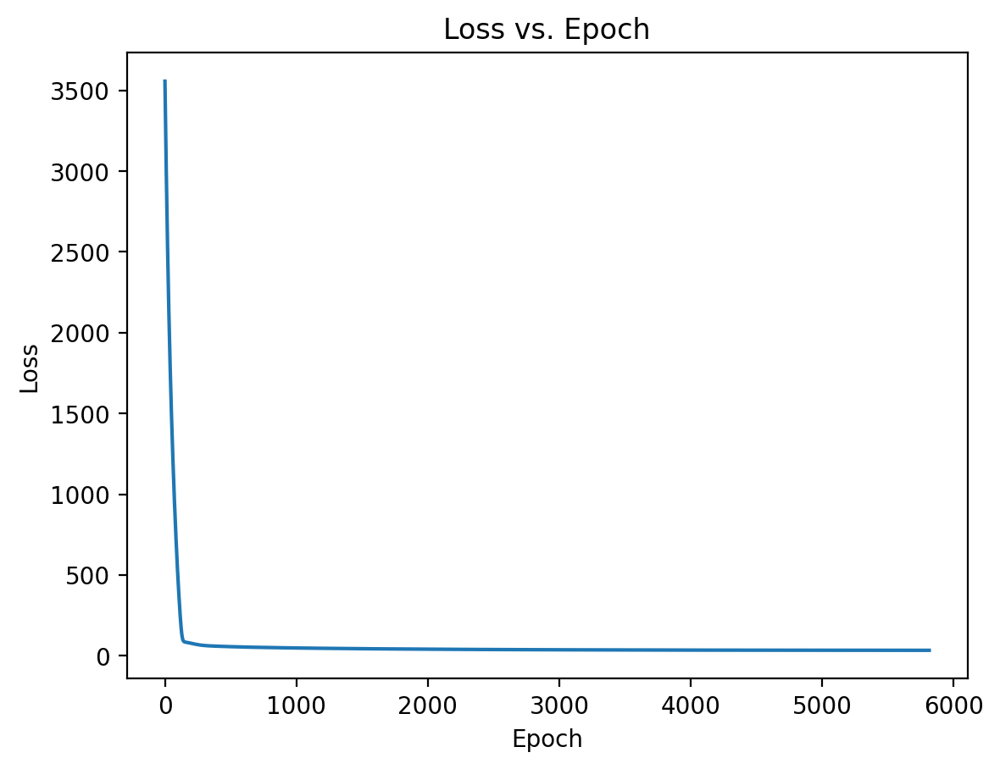

In [13]:
plt.figure()
plt.plot(losses)
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Loss vs. Epoch")

### Evaluating Matrix Factorization Performance Across Different Ranks

--------------------------------------------------
Evaluating rank: 5
--------------------------------------------------
Iteration 1000, loss: 79.38774871826172
Iteration 2000, loss: 73.79310607910156
Converged at iteration 2810, loss: 73.10588836669922
RMSE: 0.1466929018497467
PSNR: 16.671817779541016


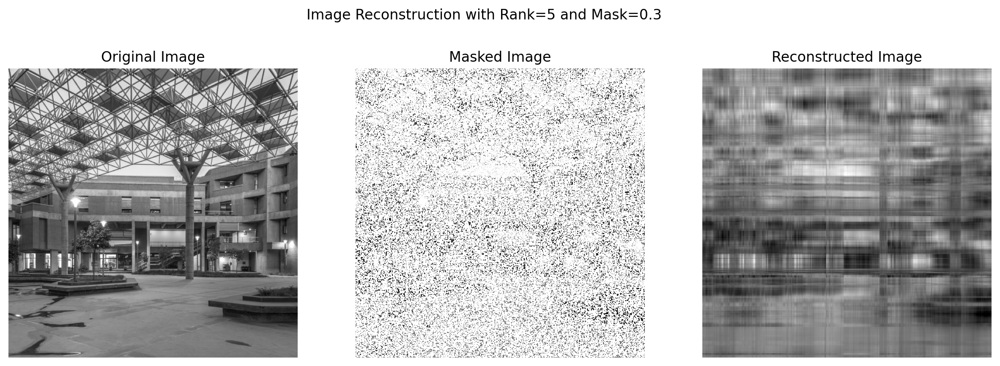




--------------------------------------------------
Evaluating rank: 10
--------------------------------------------------
Iteration 1000, loss: 71.3531265258789
Iteration 2000, loss: 63.69186019897461
Iteration 3000, loss: 61.87837219238281
Converged at iteration 3805, loss: 61.75956344604492
RMSE: 0.12550833821296692
PSNR: 18.02655029296875


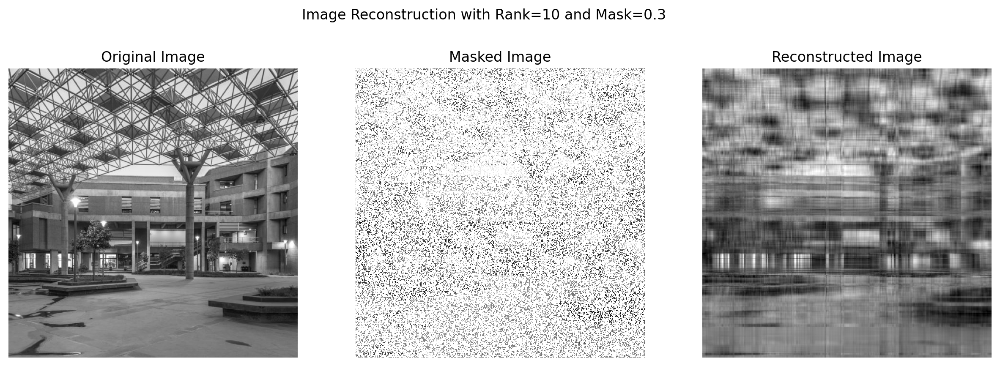




--------------------------------------------------
Evaluating rank: 20
--------------------------------------------------
Iteration 1000, loss: 63.172542572021484
Iteration 2000, loss: 54.77045822143555
Iteration 3000, loss: 51.98577117919922
Converged at iteration 3532, loss: 51.29502487182617
RMSE: 0.10636933147907257
PSNR: 19.463672637939453


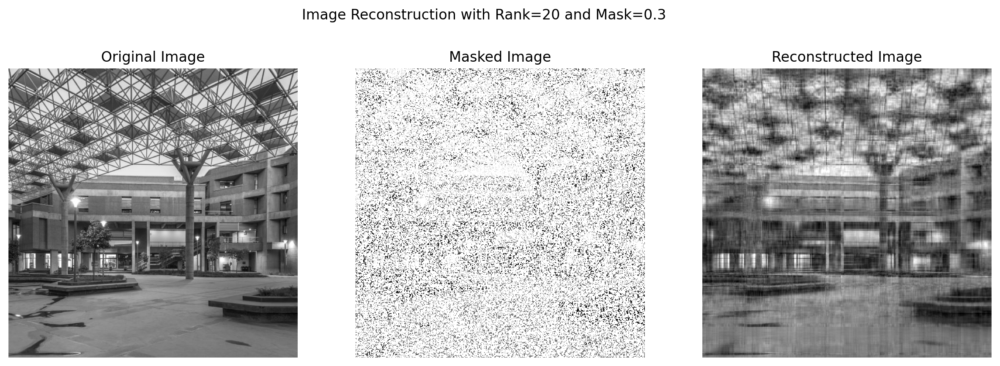




--------------------------------------------------
Evaluating rank: 50
--------------------------------------------------
Iteration 1000, loss: 48.92716598510742
Iteration 2000, loss: 41.28881072998047
Converged at iteration 2295, loss: 39.87644577026367
RMSE: 0.09020078927278519
PSNR: 20.895793914794922


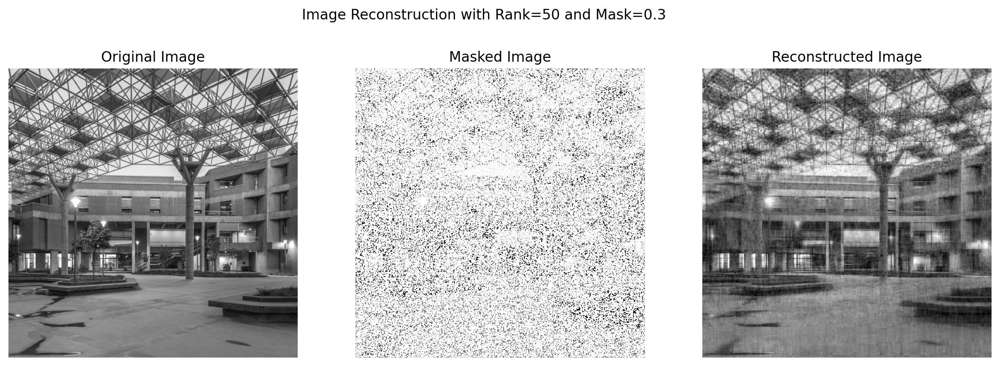




--------------------------------------------------
Evaluating rank: 100
--------------------------------------------------
Iteration 1000, loss: 37.51876449584961
Iteration 2000, loss: 29.69281768798828
Iteration 3000, loss: 25.75655174255371
Iteration 4000, loss: 23.45944595336914
Iteration 5000, loss: 21.864234924316406
Converged at iteration 5196, loss: 21.61555290222168
RMSE: 0.06678161770105362
PSNR: 23.50686264038086


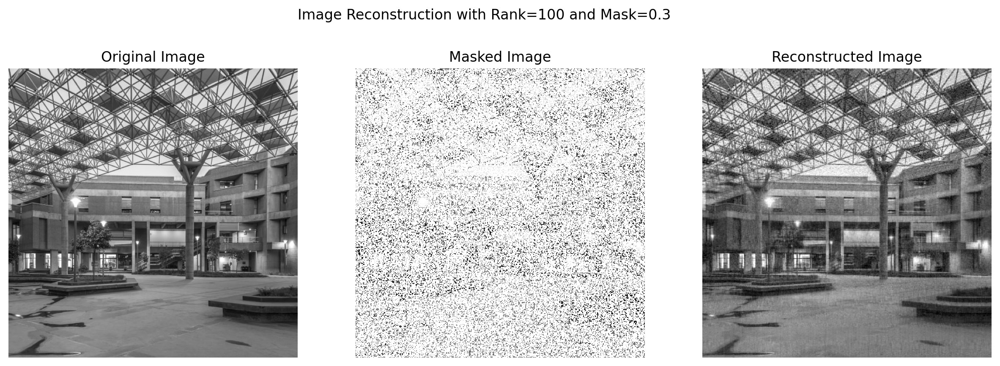




--------------------------------------------------
Evaluating rank: 200
--------------------------------------------------
Iteration 1000, loss: 25.57563018798828
Iteration 2000, loss: 19.68460464477539
Iteration 3000, loss: 16.793493270874023
Iteration 4000, loss: 14.965901374816895
Iteration 5000, loss: 13.663548469543457
Iteration 6000, loss: 12.688840866088867
Converged at iteration 6913, loss: 11.975357055664062
RMSE: 0.07276597619056702
PSNR: 22.761432647705078


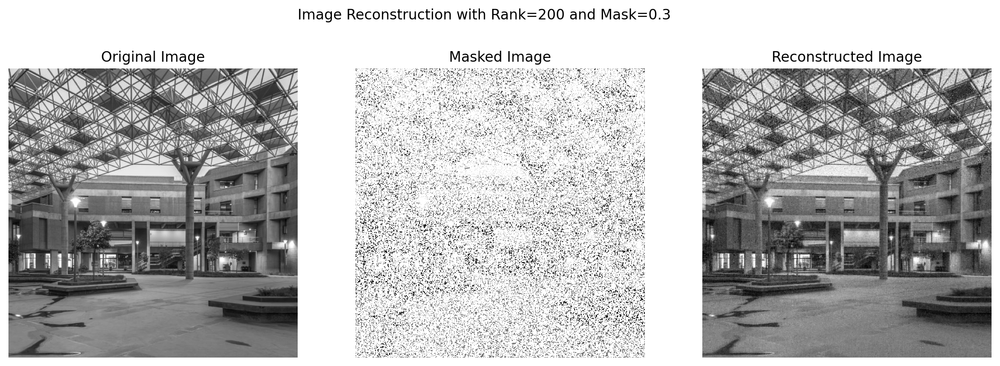




--------------------------------------------------
Evaluating rank: 400
--------------------------------------------------
Iteration 1000, loss: 14.506959915161133
Iteration 2000, loss: 9.12445068359375
Iteration 3000, loss: 8.425224304199219
Iteration 4000, loss: 8.25709342956543
Iteration 5000, loss: 8.088730812072754
Iteration 6000, loss: 7.985424518585205
Iteration 7000, loss: 7.799502849578857
Iteration 8000, loss: 7.738895893096924
Iteration 9000, loss: 7.694348335266113
Iteration 10000, loss: 7.633107662200928
RMSE: 0.2767307162284851
PSNR: 11.158852577209473


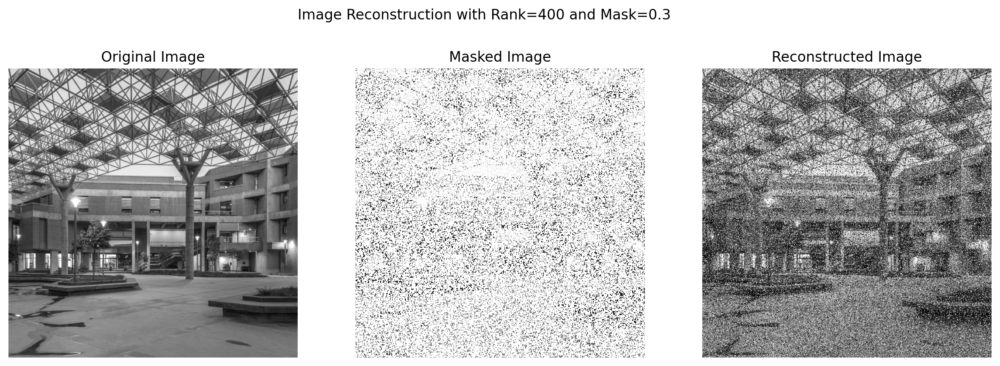

In [15]:
ranks = [5, 10, 20, 50, 100, 200, 400]
results_random = {}
reconstructed_images_random = {}

for rank in ranks:
    print("-"*50)
    print(f"Evaluating rank: {rank}")
    print("-"*50)
    reconstructed_img, masked_img, loss, losses, rmse, psnr = image_reconstruction_random(
        img_cropped, rank, mask_proportion=0.3, learning_rate=0.01, num_epochs=10000, device=device
    )
    results_random[rank] = {'Loss': loss, 'RMSE': rmse, 'PSNR': psnr}
    reconstructed_images_random[rank] = reconstructed_img
    print("\n\n")


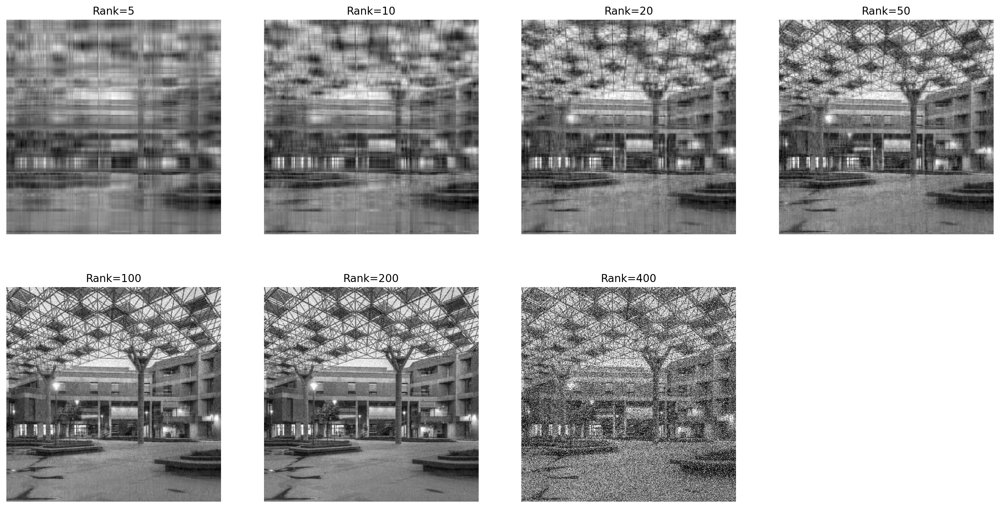

In [21]:
# show original image, masked image once and then reconstructed image for each rank
plt.figure(figsize=(20, 10))
plt.suptitle("Image Reconstruction with varying Rank")
for i, rank in enumerate(ranks):
    plt.subplot(2, len(ranks)//2+1, i+1)
    plt.imshow(reconstructed_images_random[rank].cpu().detach().numpy(), cmap='gray')
    plt.title(f"Rank={rank}")
    plt.axis('off')
plt.show()

Rank: 5, Loss: 73.10588836669922, RMSE: 0.1466929018497467, PSNR: 16.671817779541016
Rank: 10, Loss: 61.75956344604492, RMSE: 0.12550833821296692, PSNR: 18.02655029296875
Rank: 20, Loss: 51.29502487182617, RMSE: 0.10636933147907257, PSNR: 19.463672637939453
Rank: 50, Loss: 39.87644577026367, RMSE: 0.09020078927278519, PSNR: 20.895793914794922
Rank: 100, Loss: 21.61555290222168, RMSE: 0.06678161770105362, PSNR: 23.50686264038086
Rank: 200, Loss: 11.975357055664062, RMSE: 0.07276597619056702, PSNR: 22.761432647705078
Rank: 400, Loss: 7.633107662200928, RMSE: 0.2767307162284851, PSNR: 11.158852577209473


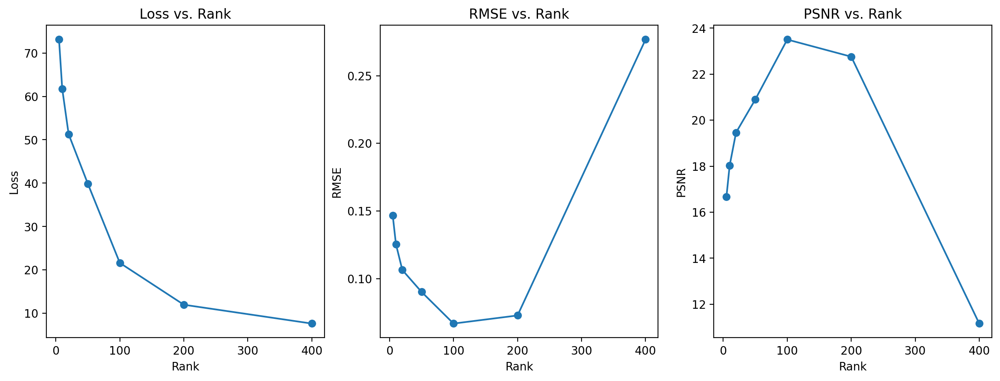

In [22]:
# Print the results for each rank
for rank, metrics in results_random.items():
    print(f"Rank: {rank}, Loss: {metrics['Loss']}, RMSE: {metrics['RMSE']}, PSNR: {metrics['PSNR']}")
    
ranks_list = list(results_random.keys())
loss_list = [metrics['Loss'].cpu().detach().numpy() for metrics in results_random.values()]
rmse_list = [metrics['RMSE'] for metrics in results_random.values()]
psnr_list = [metrics['PSNR'] for metrics in results_random.values()]

plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.plot(ranks_list, loss_list, marker='o')
plt.xlabel('Rank')
plt.ylabel('Loss')
plt.title('Loss vs. Rank')
plt.subplot(1, 3, 2)
plt.plot(ranks_list, rmse_list, marker='o')
plt.xlabel('Rank')
plt.ylabel('RMSE')
plt.title('RMSE vs. Rank')
plt.subplot(1, 3, 3)
plt.plot(ranks_list, psnr_list, marker='o')
plt.xlabel('Rank')
plt.ylabel('PSNR')
plt.title('PSNR vs. Rank')
plt.show()

# Why PSNR Increases Then Decreases with Rank

The behavior where PSNR increases until a certain rank (e.g., 100) and then starts decreasing as the rank increases (e.g., up to 400) can be explained by the following factors:

#### 1. **Overfitting to Noise**:
   - **Low ranks** (e.g., <100) provide a more compressed approximation of the matrix, capturing the most significant patterns in the data but discarding finer details.
   - As you increase the rank, the approximation improves because you're allowing more components to contribute to the reconstruction.
   - However, after a certain point, the model starts capturing not only the signal (important patterns) but also the **noise** present in the image. This leads to **overfitting**, where the approximation fits both signal and random variations (noise). Consequently, reconstruction quality degrades, and PSNR starts decreasing.

#### 2. **Signal-to-Noise Ratio (SNR)**:
   - The rank represents how many features or components are used to reconstruct the image. At lower ranks, only the dominant patterns are captured.
   - As rank increases, the approximation gets better, but beyond a certain point (e.g., rank 100), increasing rank adds less useful signal and more noise. The overall **signal-to-noise ratio (SNR)** decreases, which negatively impacts PSNR.

#### 3. **Numerical Stability and Precision**:
   - As rank increases, the factorization algorithm may become less numerically stable or more sensitive to small errors.
   - When approximating a matrix with a very high rank, precision issues can accumulate, causing the reconstruction to deteriorate.

#### 4. **Redundancy in the Data**:
   - Many real-world data matrices contain redundancy, where some pixels are highly correlated with others. As rank increases, new components may not add useful information.
   - Instead, higher ranks might duplicate information already captured by lower ranks, leading to less meaningful improvements and eventually causing overfitting.

### Visual Interpretation:
- **Low Rank (<100)**: The approximation captures the general structure but lacks detail.
- **Optimal Rank (~100)**: The balance between approximation and detail is optimal, giving the best reconstruction and highest PSNR.
- **High Rank (>100)**: The model starts overfitting, capturing unnecessary detail (and noise), causing PSNR to decline.

### Practical Example:
In low-rank approximations like Singular Value Decomposition (SVD), the first few singular values capture the most significant variation in the data. Adding more singular values adds finer details, but eventually, it starts fitting noise, causing a drop in PSNR.

### Summary:
- **Initial PSNR increase**: More signal is captured with higher rank, improving reconstruction.
- **PSNR peak**: The optimal rank strikes a balance between signal and noise, giving the best approximation.
- **PSNR decline**: Overfitting to noise occurs at higher ranks, reducing the quality of the reconstruction.

To prevent this, you can use cross-validation to find the optimal rank or apply techniques like **regularization** to avoid overfitting at higher ranks.


# Reconstruction with different Mask Proportions

--------------------------------------------------
Testing with mask proportion: 0.1
--------------------------------------------------
Iteration 1000, loss: 57.540870666503906
Iteration 2000, loss: 48.95711898803711
Converged at iteration 2528, loss: 46.343929290771484
RMSE: 0.0838908702135086
PSNR: 21.525707244873047


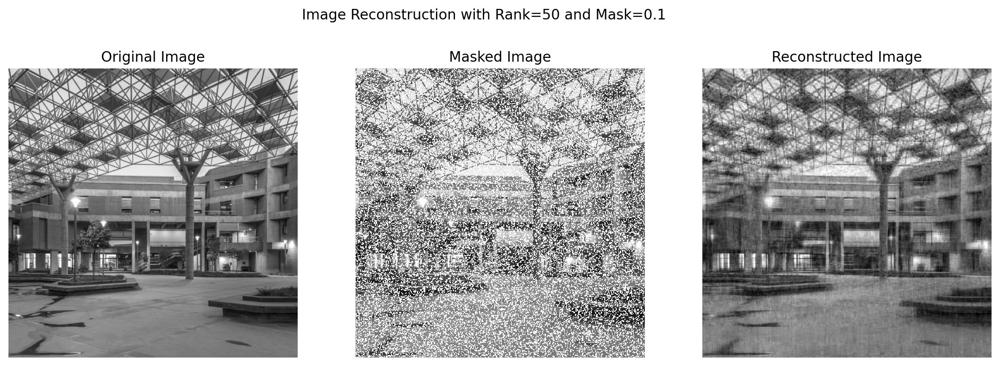




--------------------------------------------------
Testing with mask proportion: 0.3
--------------------------------------------------
Iteration 1000, loss: 49.00960922241211
Iteration 2000, loss: 41.30072021484375
Iteration 3000, loss: 37.55057907104492
Iteration 4000, loss: 35.601165771484375
Iteration 5000, loss: 34.70637512207031
Iteration 6000, loss: 34.238731384277344
Converged at iteration 6840, loss: 34.050418853759766
RMSE: 0.07990387827157974
PSNR: 21.94864273071289


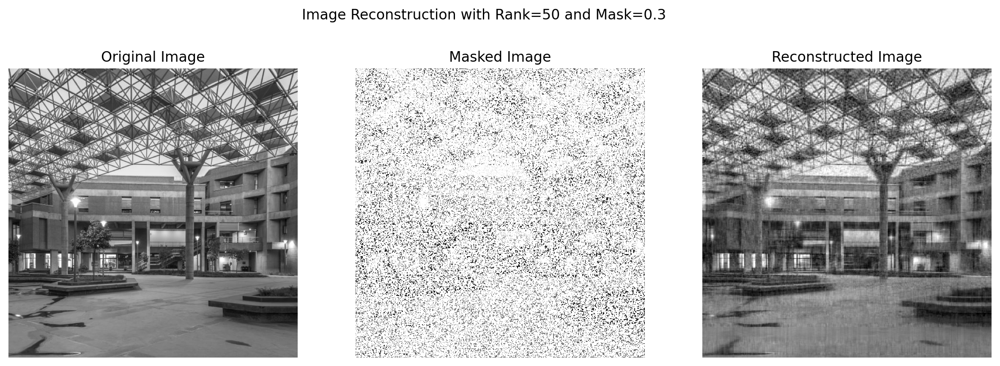




--------------------------------------------------
Testing with mask proportion: 0.5
--------------------------------------------------
Iteration 1000, loss: 38.879817962646484
Converged at iteration 1980, loss: 31.85208511352539
RMSE: 0.10330787301063538
PSNR: 19.71733283996582


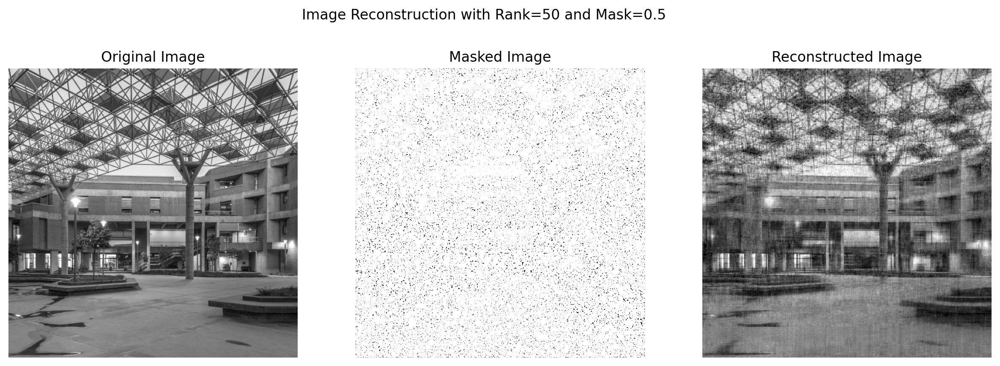




--------------------------------------------------
Testing with mask proportion: 0.7
--------------------------------------------------
Iteration 1000, loss: 23.871318817138672
Iteration 2000, loss: 17.852327346801758
Iteration 3000, loss: 15.529352188110352
Iteration 4000, loss: 14.492278099060059
Iteration 5000, loss: 13.945854187011719
Converged at iteration 5288, loss: 13.841395378112793
RMSE: 0.1584603190422058
PSNR: 16.001588821411133


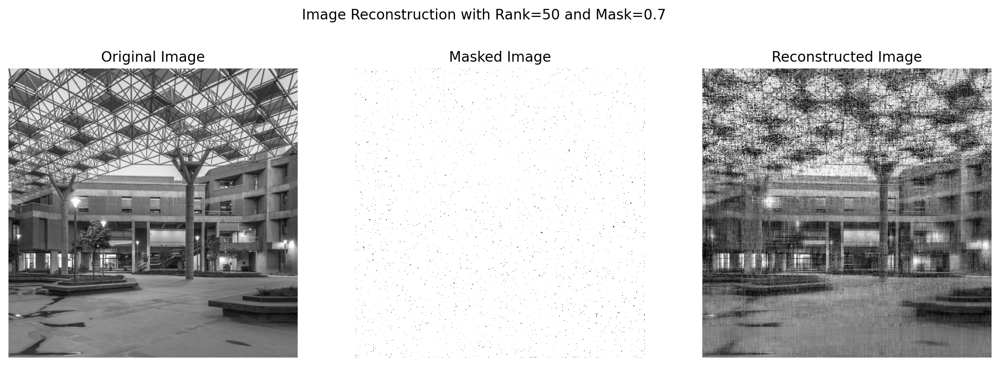




--------------------------------------------------
Testing with mask proportion: 0.9
--------------------------------------------------
Iteration 1000, loss: 1.2950156927108765
Iteration 2000, loss: 1.6942487955093384
Iteration 3000, loss: 1.223978042602539
Iteration 4000, loss: 1.1437312364578247
Iteration 5000, loss: 1.2452365159988403
Iteration 6000, loss: 1.1233149766921997
Iteration 7000, loss: 1.1188480854034424
Iteration 8000, loss: 1.27956223487854
Iteration 9000, loss: 1.1610143184661865
Iteration 10000, loss: 1.2203885316848755
RMSE: 0.4851483404636383
PSNR: 6.282508850097656


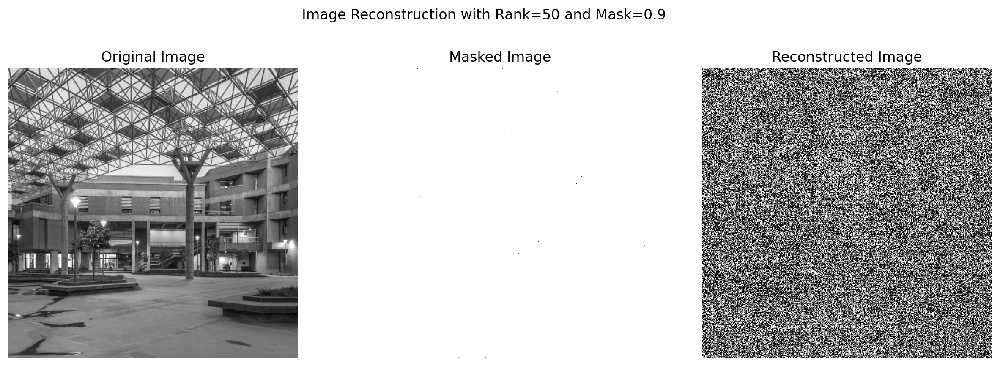

In [23]:
mask_proportions = [0.1, 0.3, 0.5, 0.7, 0.9]

results_random_masks = {}

for proportion in mask_proportions:
    print("-"*50)
    print(f"Testing with mask proportion: {proportion}")
    print("-"*50)

    # Perform image reconstruction
    reconstructed_img, masked_img, loss, losses, rmse, psnr = image_reconstruction_random(
        img_cropped,
        rank=50,
        mask_proportion=proportion,
        learning_rate=0.01,
        num_epochs=10000,
        device=device
    )

    # Store results
    results_random_masks[proportion] = {
        'Loss': loss,
        'RMSE': rmse,
        'PSNR': psnr
    }
    print("\n\n")

Mask Proportion: 0.1, Loss: 40.94473648071289, RMSE: 0.07456552237272263, PSNR: 22.549238204956055
Mask Proportion: 0.3, Loss: 37.856502532958984, RMSE: 0.086491160094738, PSNR: 21.26056671142578
Mask Proportion: 0.5, Loss: 26.583494186401367, RMSE: 0.09654278308153152, PSNR: 20.305604934692383
Mask Proportion: 0.7, Loss: 13.170829772949219, RMSE: 0.16518419981002808, PSNR: 15.640630722045898
Mask Proportion: 0.9, Loss: 1.0572701692581177, RMSE: 0.48656195402145386, PSNR: 6.257237911224365


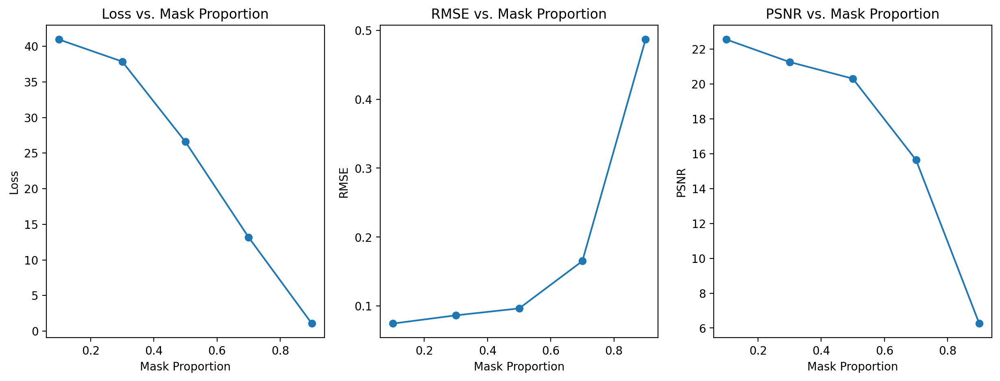

In [18]:
for proportion, metrics in results_random_masks.items():
    print(f"Mask Proportion: {proportion}, Loss: {metrics['Loss']}, RMSE: {metrics['RMSE']}, PSNR: {metrics['PSNR']}")

# Optional: Plot the Loss, RMSE, and PSNR for different mask proportions
proportions_list = list(results_random_masks.keys())
loss_list = [metrics['Loss'].cpu().detach().numpy() for metrics in results_random_masks.values()]
rmse_list = [metrics['RMSE'] for metrics in results_random_masks.values()]
psnr_list = [metrics['PSNR'] for metrics in results_random_masks.values()]

plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.plot(proportions_list, loss_list, marker='o')
plt.xlabel('Mask Proportion')
plt.ylabel('Loss')
plt.title('Loss vs. Mask Proportion')

plt.subplot(1, 3, 2)
plt.plot(proportions_list, rmse_list, marker='o')
plt.xlabel('Mask Proportion')
plt.ylabel('RMSE')
plt.title('RMSE vs. Mask Proportion')

plt.subplot(1, 3, 3)
plt.plot(proportions_list, psnr_list, marker='o')
plt.xlabel('Mask Proportion')
plt.ylabel('PSNR')
plt.title('PSNR vs. Mask Proportion')

plt.show()